Meta Analysis of the Training, Testing, Validation Datasets for Project Bike Vision

In [1]:
import os
import re
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
import json
from PIL import Image
import datetime
from datautils import *

In [2]:
path = '/Users/peter/Downloads/cam_phot'
annot_path = '/Users/peter/Downloads/via_project_8Jan2024_15h24m_csv (14).csv' 
#target_size = (352,352)

In [6]:
dic = {}
for p in os.listdir(path):
    q = re.match(r'([0-9a-fA-F-]+)-\d+\.(jpg|jpeg)',p)
    if q:
        if q.group(1) not in dic.keys():
            dic[q.group(1)] = 1
        else:
            dic[q.group(1)] += 1
    

In [5]:
##some work to rename some files so that they'll be captured by the regex. 
###this contains some circular references calling on later defined objects, do not run.
#for m in fff[fff['fname'] == 'none']['filename']:
#    source_path = os.path.join(path,m)
#    m_mute = m[:-5] + '-0.jpeg'
#    destination_path = os.path.join(path,m_mute)
#    os.rename(source_path, destination_path)

In [6]:
##remapping file system tasks, ignore.
#dict_remap_original_csv = {}
#for b in fff[fff['fname'] == 'none']['filename']:
#    dict_remap_original_csv[b] = b[:-5] + '-0.jpeg'
    
#df['filename'] = df['filename'].replace(dict_remap_original_csv)
#df.to_csv(annot_path)

In [3]:
df = pd.read_csv(annot_path)

In [4]:
fff = pd.DataFrame(df.groupby('filename')['region_count'].max()).reset_index()
fff['fname'] = fff['filename'].apply(lambda x: re.match(r'([0-9a-fA-F-]+)-\d+\.(jpg|jpeg)',x).group(1) if re.match(r'([0-9a-fA-F-]+)-\d+\.(jpg|jpeg)',x) else 'none')
fff['ct_nz'] = fff['region_count'].apply(lambda x: 1 if x> 0 else 0)
fff['ct_all'] = 1
ffg = pd.DataFrame(fff.groupby('fname')[['region_count','ct_nz','ct_all']].sum().reset_index())
ffg['examples_per_photo'] = ffg['region_count']/ffg['ct_all']
ffg['percent_examples'] = ffg['ct_nz']/ffg['ct_all']
ffh = ffg.sort_values(by = 'examples_per_photo', ascending = False)

In [5]:
#checking for losses:
assert fff[fff['fname'] == 'none']['filename'].empty

Text(0, 0.5, '% of Examples w/ Target in Training Set')

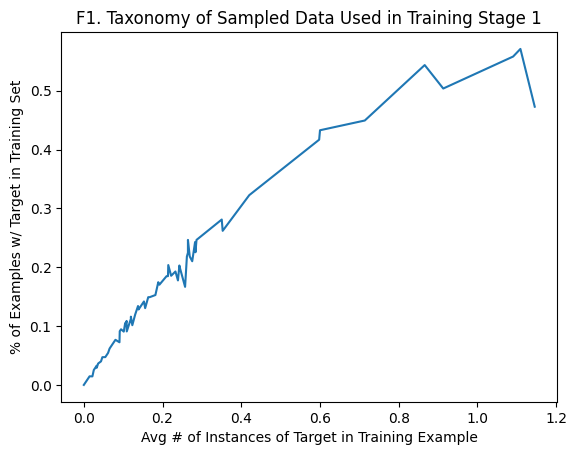

In [6]:
plt.plot(ffh['examples_per_photo'],ffh['percent_examples'])
plt.title('F1. Taxonomy of Sampled Data Used in Training Stage 1')
plt.xlabel('Avg # of Instances of Target in Training Example')
plt.ylabel('% of Examples w/ Target in Training Set')

Text(0.5, 1.0, 'F2a. Histogram of Frequency of Incidence of Target in Training Imagery')

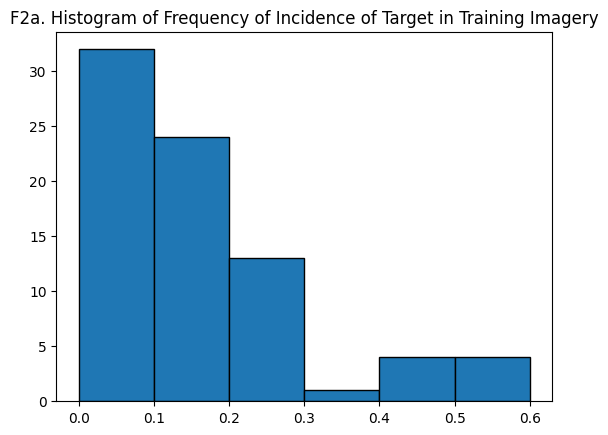

In [7]:
#histogram of the data
fh_cuts1 = [0,0.1,0.2,0.3,0.4,0.5,0.6]
#fh_cuts1_lab = [f'{lower}-{upper}'for lower, upper in zip(fh_cuts1,fh_cuts1[1:])]
fh_cuts2 = [0,0.2,0.4,0.6,0.8,1.0,1.2]
#fh_cuts2_lab = [f'{lower}-{upper}'for lower, upper in zip(fh_cuts2,fh_cuts2[1:])]
#ffh['bucket_perc'] = pd.cut(ffh['percent_examples'], bins=fh_cuts1, labels=fh_cuts1_lab, include_lowest=True, right=False)
#ffh['bucket_inst'] = pd.cut(ffh['examples_per_photo'], bins=fh_cuts2, labels=fh_cuts2_lab, include_lowest=True, right=False)

plt.hist(ffh['percent_examples'],bins=fh_cuts1, edgecolor='black')
plt.title('F2a. Histogram of Frequency of Incidence of Target in Training Imagery')

Text(0.5, 1.0, 'F2b. Histogram of Average Rate of Incidence of Target in Training Imagery')

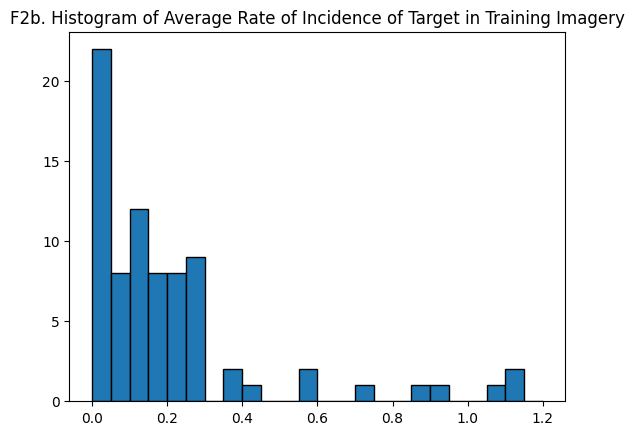

In [8]:
plt.hist(ffh['examples_per_photo'],bins=np.arange(0, 1.25, 0.05).tolist(), edgecolor='black')
plt.title('F2b. Histogram of Average Rate of Incidence of Target in Training Imagery')

Data structured in this manner makes an excellent case for transfer learning, 
as some of the sources we seek to model have very low numbers of positive examples.
The subproblem of indentifying positive examples

In [9]:
result_df = df['region_shape_attributes'].apply(json_up)
df = pd.concat([df, result_df], axis=1)

In [10]:
#df_copy = df[df['height'] != 0]

In [11]:
df_list = [getmeta(os.path.join(path, file)) for file in df['filename']]

In [12]:
df[['sample_time','imwidth','imheight']] = df_list

In [13]:
df['filenametrunc'] = df['filename'].apply(lambda x: x[:36])

In [14]:
df.shape

(22699, 16)

In [15]:
df = df[df['imwidth'] == 352] #deleting cells 

In [16]:
df.shape

(22699, 16)

In [17]:
ffh = ffh.reset_index()

In [18]:
#finding the most popular ones in the sample set
reflist = ffh['fname'][0:65].tolist()

In [135]:
from IPython.display import display, HTML

def center_image(image_path):
    display(HTML(f"<div style='text-align:center;'><img src='{image_path}' /></div>"))


In [162]:
import os
import requests
from PIL import Image, ImageDraw
from IPython.display import Markdown

def printthings(reflist):
    
    dict11 = {}
    # Create a blank canvas to draw all bounding boxes on
    #combined_image = Image.new("RGB", (800, 600), color="white")  # Adjust the size as needed
    image_path = os.path.join(path,str(reflist + '-78.jpg'))

    #combined_image = Image.new("RGB", (352, 240), color="white")  # Adjust the size as needed
    image_path = os.path.join(path,str(reflist + '-78.jpg'))
    with Image.open(image_path) as combined_image:

        draw = ImageDraw.Draw(combined_image)
        mask_master = np.zeros((24,35), dtype=np.uint8)

        # Iterate through images matching the specified filename

        matching_rows = df[df['filenametrunc'] == reflist]

        for index, row in matching_rows.iterrows():
                region_attributes = row['region_shape_attributes']
                mask = np.zeros((240,352), dtype=np.uint8)

                    # Check if region_attributes is not empty
                if region_attributes and region_attributes != '{}':
                        # Parse the region_shape_attributes JSON
                    region_attributes_dict = json.loads(region_attributes)

                        # Extract bounding box coordinates
                    x = region_attributes_dict['x']
                    y = region_attributes_dict['y']
                    width = region_attributes_dict['width']
                    height = region_attributes_dict['height']

                        # Draw bounding box on the combined image
                    draw.rectangle([x, y, x + width, y + height], outline="red")
                    mask[y:y+height, x:x+width] = 1
                    scale_factor = 0.1  # Adjust the scale factor as needed
                    rescaled_mask = zoom(mask, scale_factor, order=0)  # order=0 for nearest-neighbor interpolation


                    mask_master += rescaled_mask
                    
             

        # Save the combined image
        #combined_image.save(combined_image_path)

        # Display the combined image
        jdump = json.loads(requests.get('https://webcams.nyctmc.org/api/cameras/'+reflist).text)
       
        #Markdown(jdump['name'] + ': ' + jdump['area'] + ', ' + jdump['id'])
        plt.imshow(combined_image)
        plt.title(jdump['name'] + ': ' + jdump['area'] + ', ' + jdump['id'])
        #plt.imshow(mask_master, cmap='hot', interpolation='nearest')
        #plt.colorbar()
        #plt.show()
        plotthing(mask_master,jdump['name'],jdump['area'])
        #display(Image.fromarray(mask_master))

In [166]:
from mpl_toolkits.mplot3d import Axes3D
from scipy.ndimage import zoom

def plotthing(mask_master,name,area):
    
    # Assuming mask_master is your 2D array
    data_array = mask_master.T

    # Create a figure for plotting the data as a 3D histogram.
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    # Create an X-Y mesh of the same dimension as the 2D data.
    x_data, y_data = np.meshgrid(np.arange(data_array.shape[1]), np.arange(data_array.shape[0]))

    # Flatten out the arrays
    x_data = x_data.flatten()
    y_data = y_data.flatten()
    z_data = data_array.flatten()

    # Plot the 3D histogram with swapped x and y axes
    ax.bar3d(x_data, y_data, np.zeros(len(z_data)), 1, 1, z_data)

    # Rotate the plot along the z-axis (adjust the angle as needed)
    ax.view_init(elev=20, azim=-30)
    plt.title(f'Histogram of Pixel Activations: {name} ({area})')
    plt.ylabel('image horizon')
    # Display the plot
    plt.show()

In [ ]:
#json.loads(requests.get('https://webcams.nyctmc.org/api/cameras/'+reflist[0]).text)

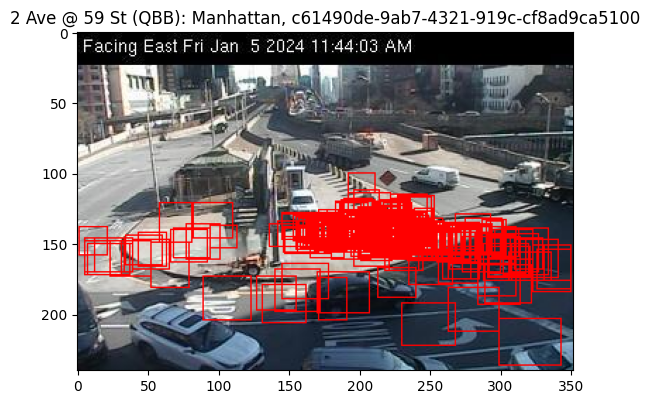

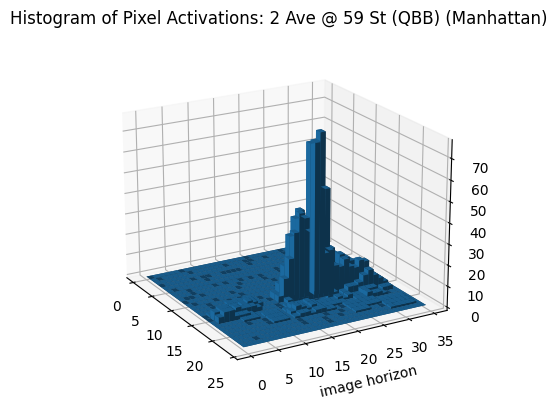

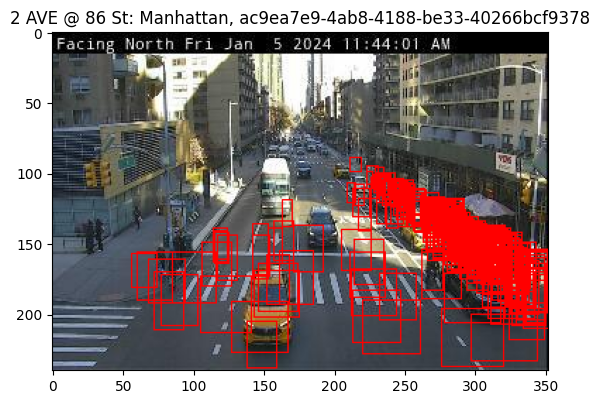

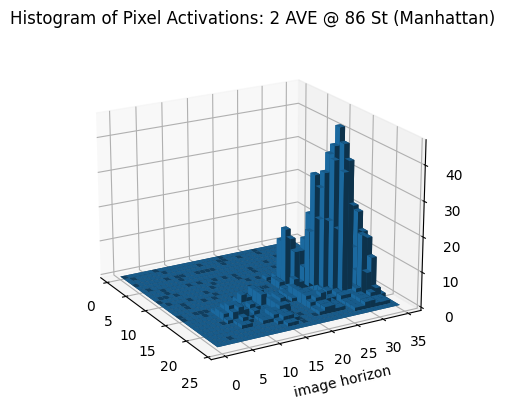

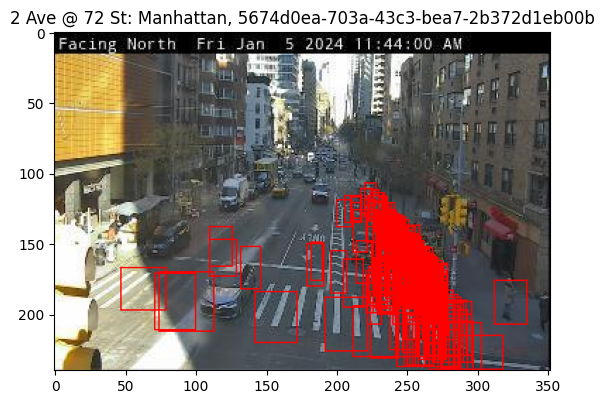

...

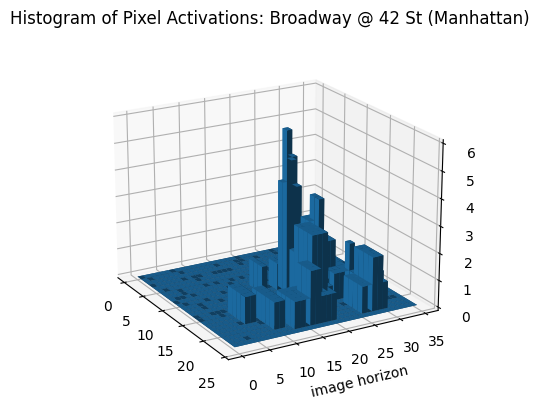

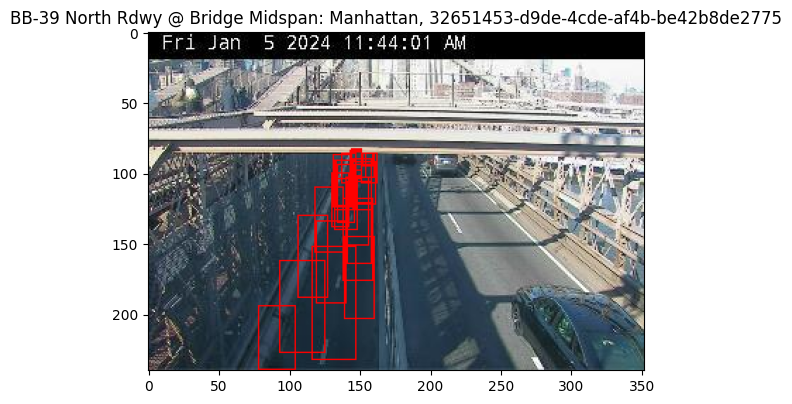

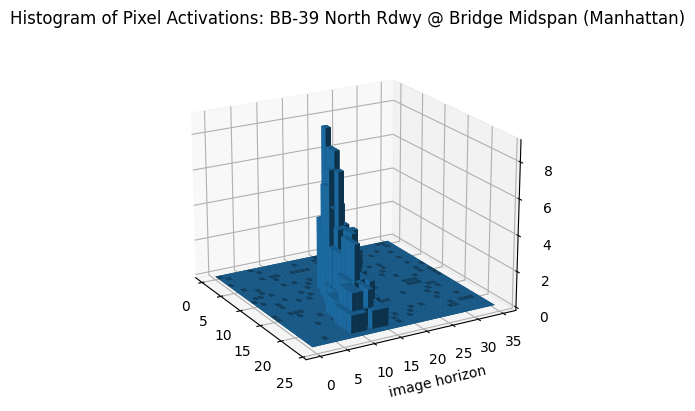

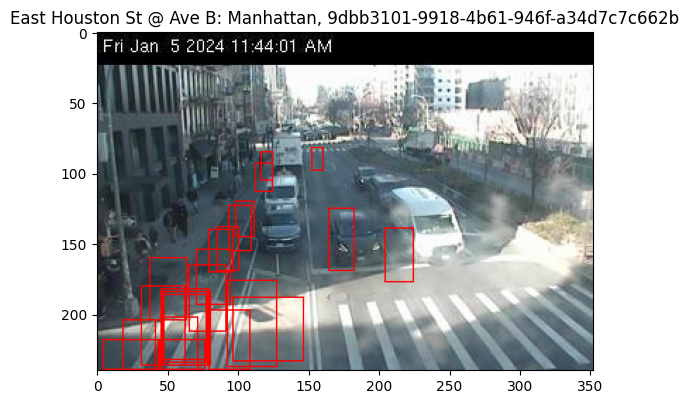

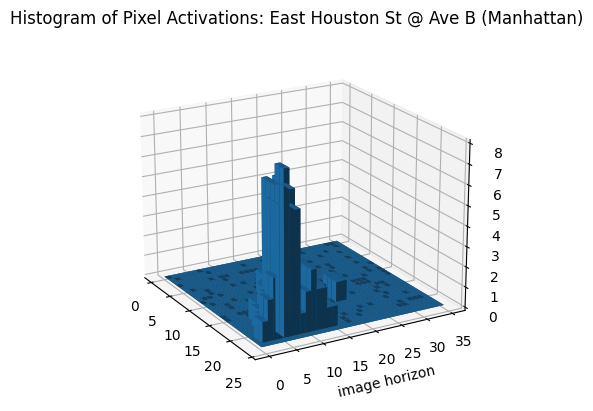

KeyError: 'name'

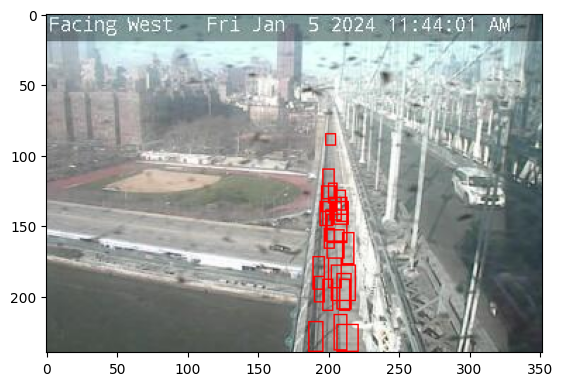

In [168]:
dest_dict2 = {}
for r in reflist:
    printthings(r)